# **Problema 2a - Aprendizaje Automático II**
# *Integrantes*:
* ### Demarré, Lucas
* ### Donnarumma, César
* ### Longo, Bruno

---

# **Tabla de contenidos**

1.   [**Librerías**](#)
2.   [**Establecemos la GPU por defecto en caso de estar disponible**](#)
3.   [**Carga y preprocesamiento del Dataset**](#)
        1.   [*Carga del Dataset*](#)
        2.   [*Información del Dataset*](#)
        3.   [*Descartamos el label*](#)
        4.   [*Chequeo de cantidad de filas de entrenamiento*](#)
        5.   [*Vista previa de algunas noticias*](#)
        6.   [*Limpieza del Dataset*](#)
        7.   [*Vista del Dataset limpio*](#)
        8.   [*Inspección del Dataset*](#)
        9.   [*Longitudes de cada articulo*](#)
                1.   [**Cálculo de longitudes**](#)
                2.   [**Medidas resumen de las longitudes**](#)
                3.   [**Construcción de intervalos para histograma**](#)
                4.   [**Histograma de longitudes**](#)
        10.  [*Unir todas las noticias en un único corpus de texto con separador '\n'*](#)
        11.  [*Cantidad de caracteres totales del corpus de texto*](#)
        12.  [*Split del corpus de texto en caracteres*](#)
        13.  [*Construcción del vocabulario*](#)
        14.  [*Análisis de frecuencia de aparición de caracter*](#)
                1.   [**Comprobamos que la suma nos da igual a la cantidad de caracteres totales del corpus**](#)
                2.   [**Medidas resumen de la frecuencia de aparicion de caracteres**](#)
                3.   [**Gráfico de aparición por caracter**](#)  
        15.  [*Ordenamos el vocabulario*](#)
        16.  [*Tamaño del vocabulario*](#)
        17.  [*Vectorización (y desvectorización) del texto*](#)
        18.  [*Convertir todo el corpus de texto spliteado a nivel caracter a un corpus de id (un id por caracter)*](#)
        19.  [*Guardar el tensor de arriba que contiene slices en un tf.dataset*](#)
        20.  [*Creación de pares (input, target) para entrenamiento*](#)
        21.  [*Función para crear Dataset de acuerdo a 'tamaño_secuencia' y 'tamaño_batch'*](#)
4.   [**Modelo 1: Una sola capa GRU con 512 celdas**](#)
        1.   [*Dataset para entrenar este modelo*](#)
        2.   [*Información del Dataset final*](#)
        3.   [*División train/validación*](#)
        4.   [*Parámetros para generar el modelo*](#)
        5.   [*Clase del modelo*](#)
        6.   [*Creación del modelo*](#)
                1.  [**Verificamos shape de salida, de paso le damos información del input de entrada para poder tirar luego el summary**](#)
                2.  [**Summary del modelo**](#)
                3.  [**Función costo**](#)
                4.  [**Compilación del modelo**](#)
                5.  [**Checkpoints del modelo**](#)
        7.   [*Ejecución del entrenamiento*](#)
                1.  [**Métricas**](#)
        8.   [*Generación de texto*](#)
                1.  [**Clase para predecir**](#)
                2.  [**Cargamos el modelo en caso de ser necesario**](#)
                3.  [**Predecimos**](#)
5.   [**Modelo 2: Una sola capa GRU de 2048 celdas**](#)
        1.   [*Dataset para entrenar este modelo*](#)
        2.   [*Información del Dataset final*](#)
        3.   [*División train/validación*](#)
        4.   [*Parámetros para generar el modelo*](#)
        5.   [*Clase del modelo*](#)
        6.   [*Creación del modelo*](#)
                1.  [**Verificamos shape de salida, de paso le damos información del input de entrada para poder tirar luego el summary**](#)
                2.  [**Summary del modelo**](#)
                3.  [**Función costo**](#)
                4.  [**Compilación del modelo**](#)
                5.  [**Checkpoints del modelo**](#)
        7.   [*Ejecución del entrenamiento*](#)
                1.  [**Métricas**](#)
        8.   [*Generación de texto*](#)
                1.  [**Clase para predecir**](#)
                2.  [**Cargamos el modelo en caso de ser necesario**](#)
                3.  [**Predecimos**](#)
6.   [**Modelo 3: Dos capas GRU**](#)
        1.   [*Dataset para entrenar este modelo*](#)
        2.   [*Información del Dataset final*](#)
        3.   [*División train/validación*](#)
        4.   [*Parámetros para generar el modelo*](#)
        5.   [*Clase del modelo*](#)
        6.   [*Creación del modelo*](#)
                1.  [**Verificamos shape de salida, de paso le damos información del input de entrada para poder tirar luego el summary**](#)
                2.  [**Summary del modelo**](#)
                3.  [**Función costo**](#)
                4.  [**Compilación del modelo**](#)
                5.  [**Checkpoints del modelo**](#)
        7.   [*Ejecución del entrenamiento*](#)
                1.  [**Métricas**](#)
        8.   [*Generación de texto*](#)
                1.  [**Clase para predecir**](#)
                2.  [**Cargamos el modelo en caso de ser necesario**](#)
                3.  [**Predecimos**](#)
7.   [**Modelo 4: Una sola capa LSTM**](#)
        1.   [*Dataset para entrenar este modelo*](#)
        2.   [*Información del Dataset final*](#)
        3.   [*División train/validación*](#)
        4.   [*Parámetros para generar el modelo*](#)
        5.   [*Clase del modelo*](#)
        6.   [*Creación del modelo*](#)
                1.  [**Verificamos shape de salida, de paso le damos información del input de entrada para poder tirar luego el summary**](#)
                2.  [**Summary del modelo**](#)
                3.  [**Función costo**](#)
                4.  [**Compilación del modelo**](#)
                5.  [**Checkpoints del modelo**](#)
        7.   [*Ejecución del entrenamiento*](#)
                1.  [**Métricas**](#)
        8.   [*Generación de texto*](#)
                1.  [**Clase para predecir**](#)
                2.  [**Cargamos el modelo en caso de ser necesario**](#)
                3.  [**Predecimos**](#)
8.   [**Conclusiones**](#)                    

## 1. **Librerías**

In [ ]:
import os
import re
import time
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

## 2. **Establecemos la GPU por defecto en caso de estar disponible**

In [ ]:
# Configuramos para que TensorFlow utilice la GPU por defecto
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Configuramos para que TensorFlow asigne memoria dinámicamente
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        # Especificamos la GPU por defecto
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        print(e) # Manejamos los errores

1 Physical GPUs, 1 Logical GPUs


## 3. **Carga y preprocesamiento del Dataset**

### 3.1. *Carga del Dataset*

In [ ]:
# Unicamente cargaremos las 120mil instancias de entrenamiento como lo dice el enunciado
ds_news, ds_news_info = tfds.load('ag_news_subset', split='train', shuffle_files=True, as_supervised=True, with_info=True)

### 3.2. *Información del Dataset*

In [ ]:
ds_news_info

tfds.core.DatasetInfo(
    name='ag_news_subset',
    full_name='ag_news_subset/1.0.0',
    description="""
    AG is a collection of more than 1 million news articles.
    News articles have been gathered from more than 2000  news sources by ComeToMyHead in more than 1 year of activity.
    ComeToMyHead is an academic news search engine which has been running since July, 2004.
    The dataset is provided by the academic comunity for research purposes in data mining (clustering, classification, etc),
    information retrieval (ranking, search, etc), xml, data compression, data streaming,
    and any other non-commercial activity.
    For more information, please refer to the link http://www.di.unipi.it/~gulli/AG_corpus_of_news_articles.html .
    
    The AG's news topic classification dataset is constructed by Xiang Zhang (xiang.zhang@nyu.edu) from the dataset above.
    It is used as a text classification benchmark in the following paper:
    Xiang Zhang, Junbo Zhao, Yann LeCun. Char

### 3.3. *Descartamos el label*

In [ ]:
ds_news = ds_news.map(lambda articulo, label: articulo)

* Para la tarea encargada el label no lo necesitamos asi que lo descartamos

### 3.4. *Chequeo de cantidad de filas de entrenamiento*

In [ ]:
print(f'Cantidad de filas de entrenamiento: {ds_news.cardinality().numpy()}')

Cantidad de filas de entrenamiento: 120000


* La cantidad coincide con la de la información del Dataset

### 3.5. *Vista previa de algunas noticias*

In [ ]:
for fila in ds_news.take(30):
  print(f'{fila.numpy()}\n')

b'AMD #39;s new dual-core Opteron chip is designed mainly for corporate computing applications, including databases, Web services, and financial transactions.'

b'Reuters - Major League Baseball\\Monday announced a decision on the appeal filed by Chicago Cubs\\pitcher Kerry Wood regarding a suspension stemming from an\\incident earlier this season.'

b'President Bush #39;s  quot;revenue-neutral quot; tax reform needs losers to balance its winners, and people claiming the federal deduction for state and local taxes may be in administration planners #39; sights, news reports say.'

b'Britain will run out of leading scientists unless science education is improved, says Professor Colin Pillinger.'

b'London, England (Sports Network) - England midfielder Steven Gerrard injured his groin late in Thursday #39;s training session, but is hopeful he will be ready for Saturday #39;s World Cup qualifier against Austria.'

b'TOKYO - Sony Corp. is banking on the \\$3 billion deal to acquire Hollywoo

* Se puede notar que los textos de las noticias estan sucios y contienen ruido en el texto que tenemos que arreglar

### 3.6. *Limpieza del Dataset*

In [ ]:
# Función para limpiar y decodificar texto
def clean_and_decode(text):
    # Decodificamos el texto de 'bytes' a 'cadena'
    text = text.numpy().decode('utf-8')
    # Reemplazamos los '#39;' con un apóstrofo
    text = re.sub(r'#39;', "'", text)
    # Eliminamos las barras invertidas
    text = re.sub(r'\\', ' ', text)
    # Eliminamos donde dice 'quot;'
    text = re.sub(r'quot;', '', text)
    # Eliminamos los ' ' antes de "'s"
    text = re.sub(r' (\'s)', r'\1', text)
    # Eliminamos los ' ' antes de "'t"
    text = re.sub(r' (\'t)', r'\1', text)
    # Eliminamos los ' ' antes de "'em"
    text = re.sub(r' (\'em)', r'\1', text)
    # Eliminamos los ' ' antes de "'"
    text = re.sub(r' (\')', r'\1', text)
    return text

# Función tf.py_function para aplicar la limpieza y decodificación
def tf_clean_and_decode(text):
    return tf.py_function(clean_and_decode, [text], tf.string)

# Aplicamos la función de limpieza y decodificación al dataset
ds_news = ds_news.map(tf_clean_and_decode)

### 3.7. *Vista del Dataset limpio*

In [ ]:
for fila in ds_news.take(30):
  print(f'{fila.numpy()}\n')

b"AMD's new dual-core Opteron chip is designed mainly for corporate computing applications, including databases, Web services, and financial transactions."

b'Reuters - Major League Baseball Monday announced a decision on the appeal filed by Chicago Cubs pitcher Kerry Wood regarding a suspension stemming from an incident earlier this season.'

b"President Bush's  revenue-neutral  tax reform needs losers to balance its winners, and people claiming the federal deduction for state and local taxes may be in administration planners' sights, news reports say."

b'Britain will run out of leading scientists unless science education is improved, says Professor Colin Pillinger.'

b"London, England (Sports Network) - England midfielder Steven Gerrard injured his groin late in Thursday's training session, but is hopeful he will be ready for Saturday's World Cup qualifier against Austria."

b'TOKYO - Sony Corp. is banking on the  $3 billion deal to acquire Hollywood studio Metro-Goldwyn-Mayer Inc..

* Como se puede ver se eliminó bastante del ruido que ensuciaba el texto de las noticias

### 3.8. *Inspección del Dataset*

In [ ]:
ds_news.element_spec

TensorSpec(shape=<unknown>, dtype=tf.string, name=None)

* shape=(), dtype=tf.string: se trata unicamente de una secuencia de texto de longitud variable

### 3.9. *Longitudes de cada articulo*

#### 3.9.1. **Cálculo de longitudes**

In [ ]:
ds_news_longitudes = ds_news.map(lambda articulo: tf.strings.length(articulo))

longitudes = list(ds_news_longitudes.as_numpy_iterator())

longitudes_ds = pd.DataFrame(longitudes, columns=['Longitud'])

#### 3.9.2. **Medidas resumen de las longitudes**

In [ ]:
longitudes_ds.describe()

,Longitud
count,120000.000000
mean,191.968725
std,64.416643
min,20.000000
25%,153.000000
50%,186.000000
75%,217.000000
max,985.000000


#### 3.9.3. **Construcción de intervalos para histograma**

In [ ]:
intervalos = np.arange(0, 1001, 100)

longitudes_intervalos = pd.cut(longitudes_ds['Longitud'], bins=intervalos)
longitudes_intervalos = longitudes_intervalos.value_counts().to_frame().reset_index().sort_values('Longitud')
longitudes_intervalos

,Longitud,count
3,"(0, 100]",4057
0,"(100, 200]",69116
1,"(200, 300]",41011
2,"(300, 400]",4269
4,"(400, 500]",1031
5,"(500, 600]",284
7,"(600, 700]",83
6,"(700, 800]",91
8,"(800, 900]",31
9,"(900, 1000]",27


#### 3.9.4. **Histograma de longitudes**

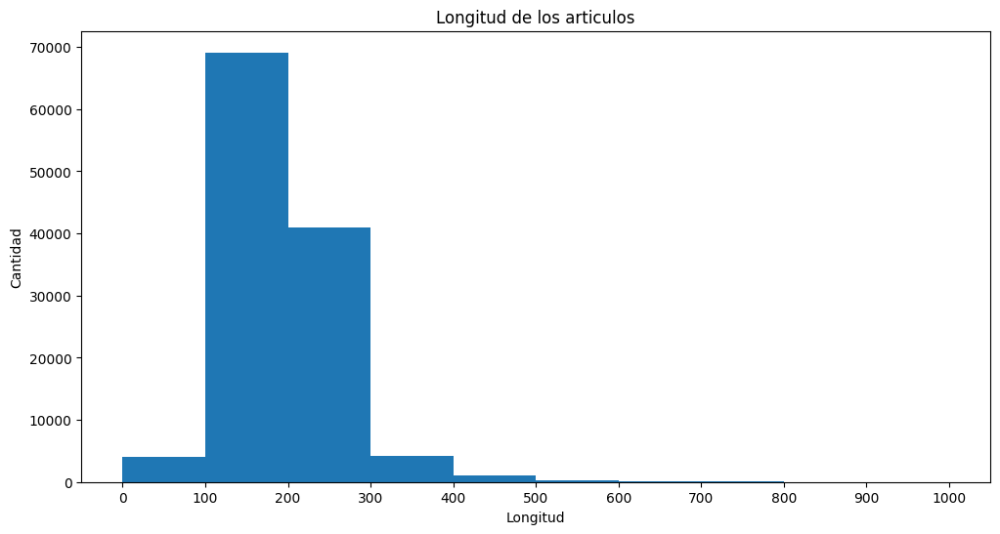

In [ ]:
plt.figure(figsize=(12,6))
plt.bar(np.arange(0,10), longitudes_intervalos['count'], align='edge', width=1)
plt.xlabel('Longitud')
plt.ylabel('Cantidad')
plt.xticks(ticks=np.arange(0,11), labels=np.arange(0,1001,100))
plt.title('Longitud de los articulos')
plt.show()

* La mayoría de los artículos tienen longitudes entre 100 y 300 caracteres

### 3.10. *Unir todas las noticias en un único corpus de texto con separador '\n'*

In [ ]:
ds_corpus_news = tf.strings.reduce_join(list(ds_news.as_numpy_iterator()), separator='\n')
ds_corpus_news

<tf.Tensor: shape=(), dtype=string, numpy=b'AMD\'s new dual-core Opteron chip is designed mainly for corporate computing applications, including databases, Web services, and financial transactions.\nReuters - Major League Baseball Monday announced a decision on the appeal filed by Chicago Cubs pitcher Kerry Wood regarding a suspension stemming from an incident earlier this season.\nPresident Bush\'s  revenue-neutral  tax reform needs losers to balance its winners, and people claiming the federal deduction for state and local taxes may be in administration planners\' sights, news reports say.\nBritain will run out of leading scientists unless science education is improved, says Professor Colin Pillinger.\nLondon, England (Sports Network) - England midfielder Steven Gerrard injured his groin late in Thursday\'s training session, but is hopeful he will be ready for Saturday\'s World Cup qualifier against Austria.\nTOKYO - Sony Corp. is banking on the  $3 billion deal to acquire Hollywood 

* Lo que se espera separando las distintas noticias con '\n' es que el modelo tome el salto de linea como fin de algo y comienzo de algo nuevo y cuando generemos luego de ello venga una nueva noticia

### 3.11. *Cantidad de caracteres totales del corpus de texto*

In [ ]:
cantidad_caracteres = tf.strings.length(ds_corpus_news, unit="UTF8_CHAR").numpy()
print(f'Cantidad de caracteres del corpus: {cantidad_caracteres}')

Cantidad de caracteres del corpus: 23156246


### 3.12. *Split del corpus de texto en caracteres*

In [ ]:
ds_corpus_split = tf.strings.unicode_split(ds_corpus_news, input_encoding='UTF-8')
print(f'{ds_corpus_split}\n')
print(ds_corpus_split.shape)

[b'A' b'M' b'D' ... b'a' b'l' b' ']

(23156246,)


* Separamos todo el texto en caracteres individuales
* Vemos que el shape del corpus separado por caracter coincide con la cantidad de caracteres totales

### 3.13. *Construcción del vocabulario*

In [ ]:
vocabulario, _, count = tf.unique_with_counts(ds_corpus_split)
vocabulario_lista = [elemento.decode('utf-8') for elemento in vocabulario.numpy()]
vocabulario

<tf.Tensor: shape=(82,), dtype=string, numpy=
array([b'A', b'M', b'D', b"'", b's', b' ', b'n', b'e', b'w', b'd', b'u',
       b'a', b'l', b'-', b'c', b'o', b'r', b'O', b'p', b't', b'h', b'i',
       b'g', b'm', b'y', b'f', b',', b'b', b'W', b'v', b'.', b'\n', b'R',
       b'j', b'L', b'B', b'C', b'K', b'P', b'x', b'E', b'(', b'S', b'N',
       b'k', b')', b'G', b'T', b'q', b'Y', b'$', b'3', b'H', b'I', b'V',
       b'U', b'F', b'7', b'6', b'5', b'J', b'2', b'0', b'z', b'/', b'4',
       b':', b'1', b'8', b'&', b';', b'Z', b'9', b'X', b'"', b'=', b'Q',
       b'?', b'#', b'!', b'_', b'*'], dtype=object)>

### 3.14. *Análisis de frecuencia de aparición de caracter*

In [ ]:
frecuencia_caracteres = pd.DataFrame(vocabulario_lista, columns=['Caracter'])
frecuencia_caracteres['Frecuencia'] = count.numpy()
frecuencia_caracteres = frecuencia_caracteres.sort_values('Frecuencia', ascending=False).reset_index(drop=True)
frecuencia_caracteres

,Caracter,Frecuencia
0,,3664506
1,e,2087077
2,a,1521319
3,t,1509871
4,i,1308140
...,...,...
77,X,2802
78,#,2614
79,!,491
80,_,184


#### 3.14.1 **Comprobamos que la suma nos da igual a la cantidad de caracteres totales del corpus**

In [ ]:
frecuencia_caracteres['Frecuencia'].sum()

23156246

#### 3.14.2. **Medidas resumen de la frecuencia de aparicion de caracteres**

In [ ]:
frecuencia_caracteres['Frecuencia'].describe()

count    8.200000e+01
mean     2.823932e+05
std      5.762432e+05
min      8.500000e+01
25%      1.601700e+04
50%      4.444150e+04
75%      2.157970e+05
max      3.664506e+06
Name: Frecuencia, dtype: float64

#### 3.14.3. Gráfico de aparición por caracter

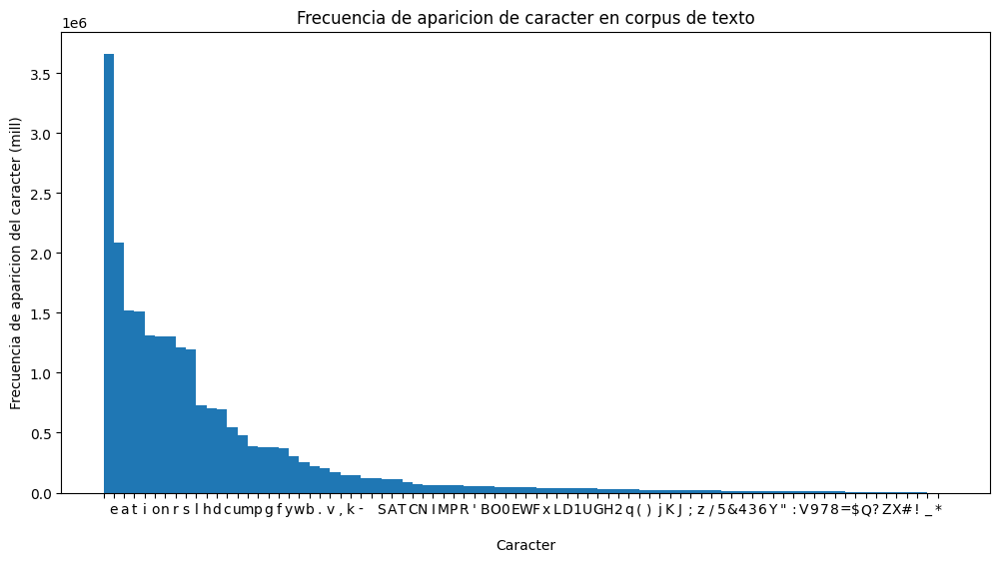

In [ ]:
plt.figure(figsize=(12,6))
plt.bar(np.arange(0,82), frecuencia_caracteres['Frecuencia'], align='edge', width=1)
plt.xlabel('Caracter')
plt.ylabel('Frecuencia de aparicion del caracter (mill)')
plt.xticks(ticks=np.arange(0,82), labels=frecuencia_caracteres['Caracter'])
plt.title('Frecuencia de aparicion de caracter en corpus de texto')
plt.show()

* El caracter más común es el 'espacio'

### 3.15. *Ordenamos el vocabulario*

In [ ]:
vocabulario_lista = sorted(vocabulario_lista)
vocabulario_lista[:15]

['\n', ' ', '!', '"', '#', '$', '&', "'", '(', ')', '*', ',', '-', '.', '/']

### 3.16. *Tamaño del vocabulario*

In [ ]:
print(f'Tamaño del vocabulario: {len(vocabulario_lista)}')

Tamaño del vocabulario: 82


### 3.17. *Vectorización (y desvectorización) del texto*

#### 3.17.1 **Convertir de caracter a id**

In [ ]:
caracter_a_id = tf.keras.layers.StringLookup(vocabulary=vocabulario_lista)

#### 3.17.2. **Convertir de id a caracter**

In [ ]:
id_a_caracter = tf.keras.layers.StringLookup(vocabulary=caracter_a_id.get_vocabulary(), invert=True)

#### 3.17.3. **Convertir de id a texto**

In [ ]:
def id_a_texto(ids):
  return tf.strings.reduce_join(id_a_caracter(ids), axis=-1)

### 3.18. *Convertir todo el corpus de texto spliteado a nivel caracter a un corpus de id (un id por caracter)*

In [ ]:
corpus_id = caracter_a_id(ds_corpus_split)
corpus_id

<tf.Tensor: shape=(23156246,), dtype=int64, numpy=array([30, 42, 33, ..., 57, 68,  2], dtype=int64)>

* Ahora tenemos un tensor donde cada elemento en vez de ser un caracter es un id que corresponde a dicho caracter.

### 3.19. *Guardar el tensor de arriba que contiene slices en un tf.dataset*

In [ ]:
ds_corpus_id = tf.data.Dataset.from_tensor_slices(corpus_id)

* Ahora tenemos un Dataset donde cada instancia es un id de caracter

### 3.20. *Creación de pares (input, target) para entrenamiento*

In [ ]:
def division_input_target(secuencia):
    input_text = secuencia[:-1]
    target_text = secuencia[1:]
    return input_text, target_text

* Con esta función de un número 'n+1' de caracteres los primeros n son el input y del 1 al n+1 el target

### 3.21. *Función para crear Dataset de acuerdo a 'tamaño_secuencia' y 'tamaño_batch'*

In [ ]:
def crear_dataset(tamaño_secuencia, tamaño_batch):
  # Agrupamos los caracteres en lotes de a tamaño_secuencia+1
  secuencias = ds_corpus_id.batch(tamaño_secuencia+1, drop_remainder=True)

  # Sobre los lotes anteriores creamos input/target
  dataset_input_target = secuencias.map(division_input_target)

  # Creamos el Dataset final
  tamaño_buffer = 10000

  dataset_input_target = (
      dataset_input_target
      # Mezclamos las instancias agarrando grupos de 'tamaño_buffer'
      .shuffle(tamaño_buffer)

      # Generamos lotes de 'tamaño_batch' (descartando las que no lleguen a ese numero)
      .batch(tamaño_batch, drop_remainder=True)

      # Precargamos en memoria
      .prefetch(tf.data.experimental.AUTOTUNE))

  return dataset_input_target

* Esta función nos termina de dar el Dataset final de acuerdo al tamaño de secuencia y tamaño de batch, así si nos interesa, de acuerdo a la arquitectura que queramos utilizar y el caso específico podemos probar diferentes variantes

## 4. **Modelo 1: Una sola capa GRU con 512 celdas**

### 4.1. *Dataset para entrenar este modelo*

In [ ]:
# Tamaño de la secuencia input/target
tamaño_secuencia = 100

# Tamaño de batch para descenso de gradiente
tamaño_batch = 64

# Creación del Dataset
dataset_input_target = crear_dataset(tamaño_secuencia, tamaño_batch)

### 4.2. *Información del dataset final*

In [ ]:
print(dataset_input_target.cardinality())

for input, target in dataset_input_target.take(1):
  print(input.shape)
  print(target.shape)

print(f'{dataset_input_target.cardinality().numpy()*input.shape[0]*input.shape[1]} caracteres')

tf.Tensor(3582, shape=(), dtype=int64)
(64, 100)
(64, 100)
22924800 caracteres


* Tenemos **3582 batches** de *64 instancias* cada uno por **100 caracteres cada una**. Es decir del dataset original quedaron **22924800 caracteres**

### 4.3. *División train/validación*

In [ ]:
batches_total = dataset_input_target.cardinality().numpy()
batches_train = round(batches_total * 0.8)
batches_valid = batches_total - batches_train

dataset_train = dataset_input_target.take(batches_train)
dataset_valid = dataset_input_target.take(batches_valid)

### 4.4. *Parámetros para generar el modelo*

In [ ]:
tamaño_vocabulario = len(caracter_a_id.get_vocabulary())
print(f'Tamaño vocabulario: {tamaño_vocabulario}')

dimension_embedding = 256
unidades_rnn = 512

Tamaño vocabulario: 83


### 4.5. *Clase del modelo*

In [ ]:
class MyModel(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim, rnn_units):
    super().__init__(self)
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.gru = tf.keras.layers.GRU(rnn_units,
                                   return_sequences=True,
                                   return_state=True)
    self.dense = tf.keras.layers.Dense(vocab_size)

  def call(self, inputs, states=None, return_state=False, training=False):
    x = inputs
    x = self.embedding(x, training=training)
    if states is None:
      states = self.gru.get_initial_state(x)
    x, states = self.gru(x, initial_state=states, training=training)
    x = self.dense(x, training=training)

    if return_state:
      return x, states
    else:
      return x

### 4.6. *Creación del modelo*

In [ ]:
model = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=unidades_rnn)

#### 4.6.1. **Verificamos shape de salida, de paso le damos información del input de entrada para poder tirar luego el summary**

In [ ]:
for input_example_batch, target_example_batch in dataset_input_target.take(1):
    example_batch_predictions = model(input_example_batch)
    print(example_batch_predictions.shape, "# (batch_size, sequence_length, vocab_size)")

(64, 100, 83) # (batch_size, sequence_length, vocab_size)


#### 4.6.2. **Summary del modelo**

In [ ]:
model.summary()

Model: "my_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       multiple                  21248     
                                                                 
 gru (GRU)                   multiple                  1182720   
                                                                 
 dense (Dense)               multiple                  42579     
                                                                 
Total params: 1,246,547
Trainable params: 1,246,547
Non-trainable params: 0
_________________________________________________________________


#### 4.6.3. **Función costo**

In [ ]:
loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

#### 4.6.4. **Compilación del modelo**

In [ ]:
model.compile(optimizer='adam', loss=loss)

#### 4.6.5. **Checkpoints del modelo**

In [ ]:
checkpoint_dir = './training_checkpoints1'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_prefix,
    save_weights_only=True)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5, mode='min', verbose=1, min_delta=0.1)

reduce_lr_on_plateau = tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='min', verbose=1, patience=3, min_delta=0.1)

### 4.7. *Ejecución del entrenamiento*

In [ ]:
epocas = 50
start = time.time()
history = model.fit(dataset_train, epochs=epocas,
                    validation_data=dataset_valid,
                    callbacks=[checkpoint_callback, early_stopping, reduce_lr_on_plateau])
end = time.time()
total_time_test1 = round((end-start)/60, 2)

print(f'--------------------------------------')
print(f'Tiempo de ejecucion: {total_time_test1} minutos')
print(f'--------------------------------------')

Epoch 1/50
2866/2866 [==============================] - 46s 15ms/step - loss: 1.5733 - val_loss: 1.2908 - lr: 0.0010
Epoch 2/50
2866/2866 [==============================] - 44s 15ms/step - loss: 1.2456 - val_loss: 1.2122 - lr: 0.0010
Epoch 3/50
2866/2866 [==============================] - 43s 15ms/step - loss: 1.1967 - val_loss: 1.1811 - lr: 0.0010
Epoch 4/50
2866/2866 [==============================] - 44s 15ms/step - loss: 1.1732 - val_loss: 1.1632 - lr: 0.0010
Epoch 5/50
2864/2866 [============================>.] - ETA: 0s - loss: 1.1591
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
2866/2866 [==============================] - 42s 15ms/step - loss: 1.1591 - val_loss: 1.1504 - lr: 0.0010
Epoch 6/50
2866/2866 [==============================] - 46s 16ms/step - loss: 1.1095 - val_loss: 1.1081 - lr: 1.0000e-04
Epoch 7/50
2866/2866 [==============================] - 45s 15ms/step - loss: 1.0992 - val_loss: 1.1015 - lr: 1.0000e-04
Epoch 8/50
2866/2866 [======

#### 4.7.1. **Métricas**

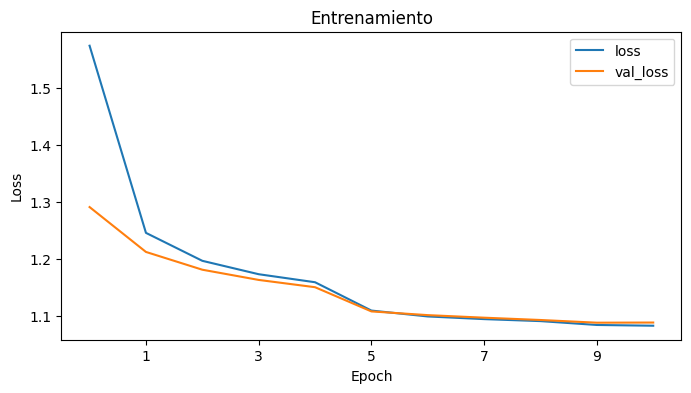

In [ ]:
metrics = history.history

plt.figure(figsize=(8,4))
plt.plot(history.epoch, metrics['loss'])
plt.plot(history.epoch, metrics['val_loss'])
plt.xticks(ticks=np.arange(1,history.epoch[-1],2))
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['loss', 'val_loss'])
plt.title('Entrenamiento')
plt.show()

* A las 9 épocas de entrenamiento la curva parece haberse estabilizado
* El overfitting es insignificante
* Parece difícil seguir bajando el loss

### 4.8. *Generación de texto*

#### 4.8.1. **Clase para predecir**

In [ ]:
class OneStep(tf.keras.Model):
  def __init__(self, model, chars_from_ids, ids_from_chars, temperature=1.0):
    super().__init__()
    self.temperature = temperature
    self.model = model
    self.chars_from_ids = id_a_caracter
    self.ids_from_chars = caracter_a_id

    skip_ids = self.ids_from_chars(['[UNK]'])[:, None]
    sparse_mask = tf.SparseTensor(
        values=[-float('inf')]*len(skip_ids),
        indices=skip_ids,
        dense_shape=[len(ids_from_chars.get_vocabulary())])
    self.prediction_mask = tf.sparse.to_dense(sparse_mask)

  @tf.function
  def generate_one_step(self, inputs, states=None):
    input_chars = tf.strings.unicode_split(inputs, 'UTF-8')
    input_ids = self.ids_from_chars(input_chars).to_tensor()

    predicted_logits, states = self.model(inputs=input_ids, states=states,
                                          return_state=True)

    predicted_logits = predicted_logits[:, -1, :]
    predicted_logits = predicted_logits/self.temperature

    predicted_logits = predicted_logits + self.prediction_mask


    predicted_ids = tf.random.categorical(predicted_logits, num_samples=1)
    predicted_ids = tf.squeeze(predicted_ids, axis=-1)


    predicted_chars = self.chars_from_ids(predicted_ids)
    return predicted_chars, states

#### 4.8.2. **Cargamos el modelo en caso de ser necesario**

Es necesario crear un modelo con la misma arquitecturas e hiperparametros que el original. El bloque de abajo es para utilizar el modelo en caso de tener los checkpoints con los pesos guardados.

In [ ]:
modelo = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=unidades_rnn)

loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

modelo.compile(optimizer='adam', loss=loss)

checkpoint_name = "mejor_modelo_1"

# Cargamos los pesos en el modelo
modelo.load_weights(checkpoint_name)

#### 4.8.3. **Predecimos**

In [ ]:
one_step_model = OneStep(model, id_a_caracter, caracter_a_id)

start = time.time()
states = None
next_char = tf.constant(['AMD'])
result = [next_char]

for n in range(2000):
  next_char, states = one_step_model.generate_one_step(next_char, states=states)
  result.append(next_char)

# Dividimos las oraciones
result = tf.strings.join(result)
result = result.numpy()[0].decode('utf-8')
oraciones = result.split(sep='\n')[:]
oraciones = oraciones[:-1]

# Mostramos las oraciones resultantes
print('---'*50+'\n')
c=1
for oracion in oraciones:
    print(f'Noticia {c}: {oracion}\n')
    c+=1
print('---'*50)
end = time.time()

print('\nRun time:', end - start, '\n')
print('---'*50)

------------------------------------------------------------------------------------------------------------------------------------------------------

Noticia 1: AMD ALEX KEss  London issued out a substantive rifle-stap that develop attacks in the days. By Time.

Noticia 2: Union forces are marked booming net playning states. 

Noticia 3: United Air Fans Gene McGred Inc. &lt;A HREF="http://www.investor.reuters.com/FullQuote.aspx?ticker=BA.N target=/stocks/quickinfo/fullquote"&gt;BYS&lt;/A&gt; agreed a pair of his exiok.

Noticia 4: Samsung Eastarm Trushed on Wednesday posted whether to boycott Intel's baseball bow shorwing Colfenega's business software in a 2 percent room line, sketter indicated relations over from the university's northern California last night, Poland's Seattle Samek Donald  Stadium are defensed and months in triple to qualix. The hurricanes that will pretayer football field goals.

Noticia 5: General Assembled a dispute, sweep of welvers with prediction that has be

* Las oraciones generadas tienen "pinta" de oración
* El modelo parece haber "aprendido" a utilizar las "," y los "." y entiende donde colocar sustantivos, verbos, adjetivos
* De algún modo capto la estructura de una oración
* En algunos casos inventa palabras
* Las oraciones no tienen demasiado sentido

## 5. **Modelo 2: Una sola capa GRU de 2048 celdas**

### 5.1. *Dataset para entrenar este modelo*

In [ ]:
# Tamaño de la secuencia input/target
tamaño_secuencia = 100

# Tamaño de batch para descenso de gradiente
tamaño_batch = 64

# Creación del Dataset
dataset_input_target = crear_dataset(tamaño_secuencia, tamaño_batch)

### 5.2. *Información del Dataset final*

In [ ]:
print(dataset_input_target.cardinality())

for input, target in dataset_input_target.take(1):
  print(input.shape)
  print(target.shape)

print(f'{dataset_input_target.cardinality().numpy()*input.shape[0]*input.shape[1]} caracteres')

tf.Tensor(3582, shape=(), dtype=int64)
(64, 100)
(64, 100)
22924800 caracteres


* Tenemos **3582 batches** de *64 instancias* cada uno por **100 caracteres cada una**. Es decir, del Dataset original quedaron **22924800 caracteres**

### 5.3. *División train/validación*

In [ ]:
batches_total = dataset_input_target.cardinality().numpy()
batches_train = round(batches_total * 0.8)
batches_valid = batches_total - batches_train

dataset_train = dataset_input_target.take(batches_train)
dataset_valid = dataset_input_target.take(batches_valid)

### 5.4. *Parámetros para generar el modelo*

In [ ]:
tamaño_vocabulario = len(caracter_a_id.get_vocabulary())
print(f'Tamaño vocabulario: {tamaño_vocabulario}')

dimension_embedding = 256
unidades_rnn = 2048

Tamaño vocabulario: 83


### 5.5. *Clase del modelo*

In [ ]:
class MyModel(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim, rnn_units):
    super().__init__(self)
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.gru = tf.keras.layers.GRU(rnn_units,
                                   return_sequences=True,
                                   return_state=True)
    self.dense = tf.keras.layers.Dense(vocab_size)

  def call(self, inputs, states=None, return_state=False, training=False):
    x = inputs
    x = self.embedding(x, training=training)
    if states is None:
      states = self.gru.get_initial_state(x)
    x, states = self.gru(x, initial_state=states, training=training)
    x = self.dense(x, training=training)

    if return_state:
      return x, states
    else:
      return x

### 5.6. *Creación del modelo*

In [ ]:
model = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=unidades_rnn)

#### 5.6.1. **Verificamos shape de salida, de paso le damos informacion del input de entrada para poder tirar luego el summary**

In [ ]:
for input_example_batch, target_example_batch in dataset_input_target.take(1):
    example_batch_predictions = model(input_example_batch)
    print(example_batch_predictions.shape, "# (batch_size, sequence_length, vocab_size)")

(64, 100, 83) # (batch_size, sequence_length, vocab_size)


#### 5.6.2. **Summary del modelo**

In [ ]:
model.summary()

Model: "my_model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     multiple                  21248     
                                                                 
 gru_1 (GRU)                 multiple                  14168064  
                                                                 
 dense_1 (Dense)             multiple                  170067    
                                                                 
Total params: 14,359,379
Trainable params: 14,359,379
Non-trainable params: 0
_________________________________________________________________


#### 5.6.3. **Función costo**

In [ ]:
loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

#### 5.6.4. **Compilación del modelo**

In [ ]:
model.compile(optimizer='adam', loss=loss)

#### 5.6.5. **Checkpoints del modelo**

In [ ]:
checkpoint_dir = './training_checkpoints1'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_prefix,
    save_weights_only=True)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5, mode='min', verbose=1, min_delta=0.1)
reduce_lr_on_plateau = tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='min', verbose=1, patience=3, min_delta=0.1)

### 5.7. *Ejecución del entrenamiento*

In [ ]:
epocas = 50
start = time.time()
history = model.fit(dataset_train, epochs=epocas,
                    validation_data=dataset_valid,
                    callbacks=[checkpoint_callback, early_stopping, reduce_lr_on_plateau])
end = time.time()
total_time_test2 = round((end-start)/60, 2)

print(f'--------------------------------------')
print(f'Tiempo de ejecucion: {total_time_test2} minutos')
print(f'--------------------------------------')

Epoch 1/50
2866/2866 [==============================] - 264s 92ms/step - loss: 1.4418 - val_loss: 1.1587 - lr: 0.0010
Epoch 2/50
2866/2866 [==============================] - 250s 87ms/step - loss: 1.1148 - val_loss: 1.0836 - lr: 0.0010
Epoch 3/50
2866/2866 [==============================] - 250s 87ms/step - loss: 1.0707 - val_loss: 1.0631 - lr: 0.0010
Epoch 4/50
2866/2866 [==============================] - 250s 87ms/step - loss: 1.0639 - val_loss: 1.0735 - lr: 0.0010
Epoch 5/50
2866/2866 [==============================] - ETA: 0s - loss: 1.0853
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
2866/2866 [==============================] - 250s 87ms/step - loss: 1.0853 - val_loss: 1.0996 - lr: 0.0010
Epoch 6/50
2866/2866 [==============================] - 250s 87ms/step - loss: 1.0233 - val_loss: 1.0026 - lr: 1.0000e-04
Epoch 7/50
2866/2866 [==============================] - 250s 87ms/step - loss: 0.9768 - val_loss: 0.9684 - lr: 1.0000e-04
Epoch 8/50
2866/2866 

#### 5.7.1. **Métricas**

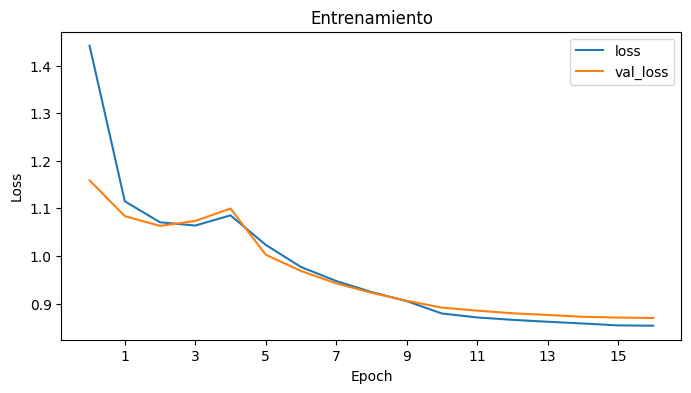

In [ ]:
metrics = history.history

plt.figure(figsize=(8,4))
plt.plot(history.epoch, metrics['loss'])
plt.plot(history.epoch, metrics['val_loss'])
plt.xticks(ticks=np.arange(1,history.epoch[-1],2))
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['loss', 'val_loss'])
plt.title('Entrenamiento')
plt.show()

* A las 13/14 épocas de entrenamiento, la curva parece haberse estabilizado
* El overfitting es insignificante nuevamente

### 5.8. *Generación de texto*

#### 5.8.1. **Clase para predecir**

In [ ]:
class OneStep(tf.keras.Model):
  def __init__(self, model, chars_from_ids, ids_from_chars, temperature=1.0):
    super().__init__()
    self.temperature = temperature
    self.model = model
    self.chars_from_ids = id_a_caracter
    self.ids_from_chars = caracter_a_id

    skip_ids = self.ids_from_chars(['[UNK]'])[:, None]
    sparse_mask = tf.SparseTensor(
        values=[-float('inf')]*len(skip_ids),
        indices=skip_ids,
        dense_shape=[len(ids_from_chars.get_vocabulary())])
    self.prediction_mask = tf.sparse.to_dense(sparse_mask)

  @tf.function
  def generate_one_step(self, inputs, states=None):
    input_chars = tf.strings.unicode_split(inputs, 'UTF-8')
    input_ids = self.ids_from_chars(input_chars).to_tensor()

    predicted_logits, states = self.model(inputs=input_ids, states=states,
                                          return_state=True)

    predicted_logits = predicted_logits[:, -1, :]
    predicted_logits = predicted_logits/self.temperature
    predicted_logits = predicted_logits + self.prediction_mask


    predicted_ids = tf.random.categorical(predicted_logits, num_samples=1)
    predicted_ids = tf.squeeze(predicted_ids, axis=-1)

    predicted_chars = self.chars_from_ids(predicted_ids)
    return predicted_chars, states

#### 5.8.2. **Cargamos el modelo en caso de ser necesario**

Es necesario crear un modelo con la misma arquitecturas e hiperparametros que el original. El bloque de abajo es para utilizar el modelo en caso de tener los checkpoints con los pesos guardados.

In [ ]:
modelo = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=unidades_rnn)

loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

modelo.compile(optimizer='adam', loss=loss)

checkpoint_name = "mejor_modelo_1"

# Cargamos los pesos en el modelo
modelo.load_weights(checkpoint_name)

#### 5.8.3. **Predecimos**

In [ ]:
one_step_model = OneStep(model, id_a_caracter, caracter_a_id)

start = time.time()
states = None
next_char = tf.constant(['AMD'])
result = [next_char]

for n in range(2000):
  next_char, states = one_step_model.generate_one_step(next_char, states=states)
  result.append(next_char)

# Dividimos las oraciones
result = tf.strings.join(result)
result = result.numpy()[0].decode('utf-8')
oraciones = result.split(sep='\n')[:]
oraciones = oraciones[:-1]

# Mostramos las oraciones resultantes
print('---'*50+'\n')
c=1
for oracion in oraciones:
    print(f'Noticia {c}: {oracion}\n')
    c+=1
print('---'*50)
end = time.time()

print('\nRun time:', end - start, '\n')
print('---'*50)

------------------------------------------------------------------------------------------------------------------------------------------------------

Noticia 1: AMD (NYSE:NBS) game downloader: Java 6, also  $499,000, is clear. You'd dream and like a wind forgiving, a reported on this manopure. The characterizing choked by Highbury, 80 km (530 PM) appears to be NCDAft's Network) - Nothing will make an impressive game of their golf courses  early yesterday, where he stepped down in routing your NFL 8000ard tomorrow. The 24-year-old Cardinals lined at Highbury on Saturday against the St. Louis Cardinals in Game 4 losses rattled his ballot following their second birthday to win all online rating on the Web again, Will Chavez, make no committee if the company followed US goods.

Noticia 2:  SAN FRANCISCO (Reuters) - The firm detained on Saturday with a three-year asseumed on hands on run over Massachusetts Rugby Wodah, Beckh's foreign minister said yesterday in a deal shuttle 

Noticia 3:

* Las oraciones generadas nuevamente parecen oraciones
* Mantiene el buen uso de las comas y los puntos y entiende un poco mejor dónde colocar sustantivos, verbos y adjetivos
* Sigue inventando palabras en algunas oraciones
* Aunque algunas partes pueden ser "rescatables", las oraciones siguen sin tener demasiado sentido y carecen de coherencia lógica

## 6. **Modelo 3: Dos capas GRU**

### 6.1. *Dataset para entrenar este modelo*

In [ ]:
# Tamaño de la secuencia input/target
tamaño_secuencia = 100

# Tamaño de batch para descenso de gradiente
tamaño_batch = 64

# Creación del Dataset
dataset_input_target = crear_dataset(tamaño_secuencia, tamaño_batch)

### 6.2. *Información del Dataset final*

In [ ]:
print(dataset_input_target.cardinality())

for input, target in dataset_input_target.take(1):
  print(input.shape)
  print(target.shape)

print(f'{dataset_input_target.cardinality().numpy()*input.shape[0]*input.shape[1]} caracteres')

tf.Tensor(3582, shape=(), dtype=int64)
(64, 100)
(64, 100)
22924800 caracteres


* Tenemos **3582 batches** de *64 instancias* cada uno por **100 caracteres** cada una. Es decir, del Dataset original quedaron **22924800 caracteres**

### 6.3. *División train/validación*

In [ ]:
batches_total = dataset_input_target.cardinality().numpy()
batches_train = round(batches_total * 0.8)
batches_valid = batches_total - batches_train

dataset_train = dataset_input_target.take(batches_train)
dataset_valid = dataset_input_target.take(batches_valid)

### 6.4. *Parámetros para generar el modelo*

In [ ]:
tamaño_vocabulario = len(caracter_a_id.get_vocabulary())
print(f'Tamaño vocabulario: {tamaño_vocabulario}')

dimension_embedding = 256
rnn_1_units = 2048
rnn_2_units = 1024

Tamaño vocabulario: 83


### 6.5. *Clase del modelo*

In [ ]:
class MyModel(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim, rnn_units):
    super().__init__(self)
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.gru_1 = tf.keras.layers.GRU(rnn_units[0],
                                   return_sequences=True,
                                   return_state=True)
    self.gru_2 = tf.keras.layers.GRU(rnn_units[1],
                                   return_sequences=True,
                                   return_state=True)
    self.dense = tf.keras.layers.Dense(vocab_size)

  # Training=False indica que call funciona en modo inferencia
  def call(self, inputs, states=None, return_state=False, training=False):
    x = inputs
    x = self.embedding(x, training=training)
    if states is None:
      state_1 = self.gru_1.get_initial_state(x)
      states=[state_1]
    x, state_1 = self.gru_1(x, initial_state=states[0], training=training)
    if len(states) < 2:
      state_2 = self.gru_2.get_initial_state(x)
      states.append(state_2)
    x, state_2 = self.gru_2(x, initial_state=states[1], training=training)
    x = self.dense(x, training=training)

    if return_state:
      return x, [state_1, state_2]
    else:
      return x

### 6.6. *Creación del modelo*

In [ ]:
model = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=[rnn_1_units, rnn_2_units])

#### 6.6.1. **Verificamos shape de salida, de paso le damos informacion del input de entrada para poder tirar luego el summary**

In [ ]:
for input_example_batch, target_example_batch in dataset_input_target.take(1):
    example_batch_predictions = model(input_example_batch)
    print(example_batch_predictions.shape, "# (batch_size, sequence_length, vocab_size)")

(64, 100, 83) # (batch_size, sequence_length, vocab_size)


#### 6.6.2. **Summary del modelo**

In [ ]:
model.summary()

Model: "my_model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     multiple                  21248     
                                                                 
 gru_2 (GRU)                 multiple                  14168064  
                                                                 
 gru_3 (GRU)                 multiple                  9443328   
                                                                 
 dense_2 (Dense)             multiple                  85075     
                                                                 
Total params: 23,717,715
Trainable params: 23,717,715
Non-trainable params: 0
_________________________________________________________________


#### 6.6.3. **Función costo**

In [ ]:
loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

#### 6.6.4. **Compilación del modelo**

In [ ]:
model.compile(optimizer='adam', loss=loss)

#### 6.6.5. **Checkpoints del modelo**

In [ ]:
checkpoint_dir = './training_checkpoints1'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_prefix,
    save_weights_only=True)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5, mode='min', verbose=1, min_delta=0.1)
reduce_lr_on_plateau = tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='min', verbose=1, patience=3, min_delta=0.1)

### 6.7. *Ejecución del entrenamiento*

In [ ]:
epocas = 50
start = time.time()
history = model.fit(dataset_train, epochs=epocas,
                    validation_data=dataset_valid,
                    callbacks=[checkpoint_callback, early_stopping, reduce_lr_on_plateau])
end = time.time()
total_time_test3 = round((end-start)/60, 2)

print(f'--------------------------------------')
print(f'Tiempo de ejecucion: {total_time_test3} minutos')
print(f'--------------------------------------')

Epoch 1/50
2866/2866 [==============================] - 415s 144ms/step - loss: 1.1629 - val_loss: 1.1545 - lr: 1.0000e-04
Epoch 2/50
2866/2866 [==============================] - 416s 145ms/step - loss: 1.1433 - val_loss: 1.1368 - lr: 1.0000e-04
Epoch 3/50
2866/2866 [==============================] - 416s 145ms/step - loss: 1.1244 - val_loss: 1.1180 - lr: 1.0000e-04
Epoch 4/50
2866/2866 [==============================] - ETA: 0s - loss: 1.1068
Epoch 4: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
2866/2866 [==============================] - 416s 145ms/step - loss: 1.1068 - val_loss: 1.1009 - lr: 1.0000e-04
Epoch 5/50
2866/2866 [==============================] - 416s 145ms/step - loss: 1.0797 - val_loss: 1.0824 - lr: 1.0000e-05
Epoch 6/50
2866/2866 [==============================] - 416s 145ms/step - loss: 1.0699 - val_loss: 1.0754 - lr: 1.0000e-05
Epoch 6: early stopping
--------------------------------------
Tiempo de ejecucion: 41.58 minutos
-------------------

#### 6.7.1. *Métricas*

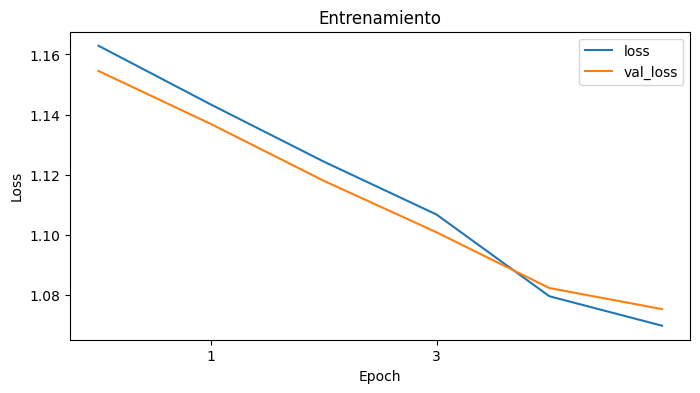

In [ ]:
metrics = history.history

plt.figure(figsize=(8,4))
plt.plot(history.epoch, metrics['loss'])
plt.plot(history.epoch, metrics['val_loss'])
plt.xticks(ticks=np.arange(1,history.epoch[-1],2))
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['loss', 'val_loss'])
plt.title('Entrenamiento')
plt.show()

* El modelo no llegó a estabilizarse del todo
* El overfitting es insignificante nuevamente

### 6.8. *Generación de texto*

#### 6.8.1. **Clase para predecir**

In [ ]:
class OneStep(tf.keras.Model):
  def __init__(self, model, chars_from_ids, ids_from_chars, temperature=1.0):
    super().__init__()
    self.temperature = temperature
    self.model = model
    self.chars_from_ids = id_a_caracter
    self.ids_from_chars = caracter_a_id

    skip_ids = self.ids_from_chars(['[UNK]'])[:, None]
    sparse_mask = tf.SparseTensor(
        values=[-float('inf')]*len(skip_ids),
        indices=skip_ids,
        dense_shape=[len(ids_from_chars.get_vocabulary())])
    self.prediction_mask = tf.sparse.to_dense(sparse_mask)

  @tf.function
  def generate_one_step(self, inputs, states=None):
    input_chars = tf.strings.unicode_split(inputs, 'UTF-8')
    input_ids = self.ids_from_chars(input_chars).to_tensor()

    predicted_logits, states = self.model(inputs=input_ids, states=states,
                                          return_state=True)

    predicted_logits = predicted_logits[:, -1, :]
    predicted_logits = predicted_logits/self.temperature
    predicted_logits = predicted_logits + self.prediction_mask

    predicted_ids = tf.random.categorical(predicted_logits, num_samples=1)
    predicted_ids = tf.squeeze(predicted_ids, axis=-1)

    predicted_chars = self.chars_from_ids(predicted_ids)
    return predicted_chars, states

#### 6.8.2. **Cargamos el modelo en caso de ser necesario**

Es necesario crear un modelo con la misma arquitecturas e hiperparametros que el original. El bloque de abajo es para utilizar el modelo en caso de tener los checkpoints con los pesos guardados.

In [ ]:
modelo = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=unidades_rnn)

loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

modelo.compile(optimizer='adam', loss=loss)

checkpoint_name = "mejor_modelo_1"

# Cargamos los pesos en el modelo
modelo.load_weights(checkpoint_name)

#### 6.8.3. **Predecimos**

In [ ]:
one_step_model = OneStep(model, id_a_caracter, caracter_a_id)

start = time.time()
states = None
next_char = tf.constant(['AMD'])
result = [next_char]

for n in range(2000):
  next_char, states = one_step_model.generate_one_step(next_char, states=states)
  result.append(next_char)

# Dividimos las oraciones
result = tf.strings.join(result)
result = result.numpy()[0].decode('utf-8')
oraciones = result.split(sep='\n')[:]
oraciones = oraciones[:-1]

# Mostramos las oraciones resultantes
print('---'*50+'\n')
c=1
for oracion in oraciones:
    print(f'Noticia {c}: {oracion}\n')
    c+=1
print('---'*50)
end = time.time()

print('\nRun time:', end - start, '\n')
print('---'*50)

------------------------------------------------------------------------------------------------------------------------------------------------------

Noticia 1: AMD Airbus, but targeted all under the atomic companies tally going to themselves and resolved. By Yao. She left Martinez overturned child.

Noticia 2: NEW YORK New applications to extending the false business and sharp drugs, Barbuda was ordered to force the United States on Friday night. Howeville. When they who our physide Geoff Hoor, Dec...

Noticia 3: Reuters - Iran Solution meet hundreds of software forward from bridgesting her party and Customs regressed but also ingenesballed the key to be produce its outlook for Dec 3 independence. The campaigner bomb blast vows to claims. Offs and opposition on her kneeling the world game. It between American Jose Mourinho's second largest race leader Jack Creek atrocities and US forces took offerings in which its fight action nearing demand post.

Noticia 4: Macs their threatened b

* Las oraciones se mantienen en la misma linea que los dos anteriores modelos
* Mantiene el buen uso de las comas y los puntos. Entiende un poco mejor dónde colocar sustantivos, verbos y adjetivos al igual que el segundo modelo
* Sigue inventando palabras en algunas oraciones como los anteriores
* Esta vez menos cosas "rescatables", las oraciones siguen sin tener demasiado sentido y carentes de coherencia

## 7. **Modelo 4: Una sola capa LSTM**

### 7.1. *Dataset para entrenar este modelo*

In [ ]:
# Tamaño de la secuencia input/target
tamaño_secuencia = 100

# Tamaño de batch para descenso de gradiente
tamaño_batch = 64

# Creación del Dataset
dataset_input_target = crear_dataset(tamaño_secuencia, tamaño_batch)

### 7.2. *Información del Dataset final*

In [ ]:
print(dataset_input_target.cardinality())

for input, target in dataset_input_target.take(1):
  print(input.shape)
  print(target.shape)

print(f'{dataset_input_target.cardinality().numpy()*input.shape[0]*input.shape[1]} caracteres')

tf.Tensor(3582, shape=(), dtype=int64)
(64, 100)
(64, 100)
22924800 caracteres


* Tenemos **3582 batches** de *64 instancias* cada uno por **100 caracteres** cada una. Es decir, del Dataset original quedaron **22924800 caracteres**

### 7.3. *División train/validación*

In [ ]:
batches_total = dataset_input_target.cardinality().numpy()
batches_train = round(batches_total * 0.8)
batches_valid = batches_total - batches_train

dataset_train = dataset_input_target.take(batches_train)
dataset_valid = dataset_input_target.take(batches_valid)

### 7.4. *Parámetros para generar el modelo*

In [ ]:
tamaño_vocabulario = len(caracter_a_id.get_vocabulary())
print(f'Tamaño vocabulario: {tamaño_vocabulario}')

dimension_embedding = 256
rnn_units = 2048

Tamaño vocabulario: 83


### 7.5. *Clase del modelo*

In [ ]:
class MyModel(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim, rnn_units):
    super().__init__(self)
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.lstm = tf.keras.layers.LSTM(rnn_units,
                                   return_sequences=True,
                                   return_state=True)
    self.dense = tf.keras.layers.Dense(vocab_size)

  # Training=False indica que call funciona en modo inferencia
  def call(self, inputs, states=None, return_state=False, training=False):
    x = inputs
    x = self.embedding(x, training=training)
    if states is None:
      final_memory_state, final_carry_state = self.lstm.get_initial_state(x)
      states=[final_memory_state, final_carry_state]
    x, final_memory_state, final_carry_state = self.lstm(x, initial_state=states, training=training)
    x = self.dense(x, training=training)

    if return_state:
      return x, [final_memory_state, final_carry_state]
    else:
      return x

### 7.6. *Creación del modelo*

In [ ]:
model = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=rnn_units)

#### 7.6.1. **Verificamos shape de salida, de paso le damos informacion del input de entrada para poder tirar luego el summary**

In [ ]:
for input_example_batch, target_example_batch in dataset_input_target.take(1):
    example_batch_predictions = model(input_example_batch)
    print(example_batch_predictions.shape, "# (batch_size, sequence_length, vocab_size)")

(64, 100, 83) # (batch_size, sequence_length, vocab_size)


#### 7.6.2. **Summary del modelo**

In [ ]:
model.summary()

Model: "my_model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_4 (Embedding)     multiple                  21248     
                                                                 
 lstm_1 (LSTM)               multiple                  18882560  
                                                                 
 dense_4 (Dense)             multiple                  170067    
                                                                 
Total params: 19,073,875
Trainable params: 19,073,875
Non-trainable params: 0
_________________________________________________________________


#### 7.6.3. **Función costo**

In [ ]:
loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

#### 7.6.4. **Compilación del modelo**

In [ ]:
model.compile(optimizer='adam', loss=loss)

#### 7.6.5. **Checkpoints del modelo**

In [ ]:
checkpoint_dir = './training_checkpoints1'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_prefix,
    save_weights_only=True)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5, mode='min', verbose=1, min_delta=0.1)
reduce_lr_on_plateau = tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='min', verbose=1, patience=3, min_delta=0.1)

### 7.7. **Ejecución del entrenamiento**

In [ ]:
epocas = 50
start = time.time()
history = model.fit(dataset_train, epochs=epocas,
                    validation_data=dataset_valid,
                    callbacks=[checkpoint_callback, early_stopping, reduce_lr_on_plateau])
end = time.time()
total_time_test4 = round((end-start)/60, 2)

print(f'--------------------------------------')
print(f'Tiempo de ejecucion: {total_time_test4} minutos')
print(f'--------------------------------------')

Epoch 1/50
2866/2866 [==============================] - 344s 119ms/step - loss: 1.4597 - val_loss: 1.1468 - lr: 0.0010
Epoch 2/50
2866/2866 [==============================] - 338s 118ms/step - loss: 1.0863 - val_loss: 1.0385 - lr: 0.0010
Epoch 3/50
2866/2866 [==============================] - 332s 115ms/step - loss: 1.0127 - val_loss: 0.9889 - lr: 0.0010
Epoch 4/50
2866/2866 [==============================] - 343s 119ms/step - loss: 0.9713 - val_loss: 0.9601 - lr: 0.0010
Epoch 5/50
2866/2866 [==============================] - 345s 120ms/step - loss: 0.9474 - val_loss: 0.9436 - lr: 0.0010
Epoch 6/50
2866/2866 [==============================] - 370s 129ms/step - loss: 0.9377 - val_loss: 0.9396 - lr: 0.0010
Epoch 7/50
2866/2866 [==============================] - ETA: 0s - loss: 0.9367
Epoch 7: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
2866/2866 [==============================] - 1366s 476ms/step - loss: 0.9367 - val_loss: 0.9403 - lr: 0.0010
Epoch 8/50
2866/2866 

#### 7.7.1. **Métricas**

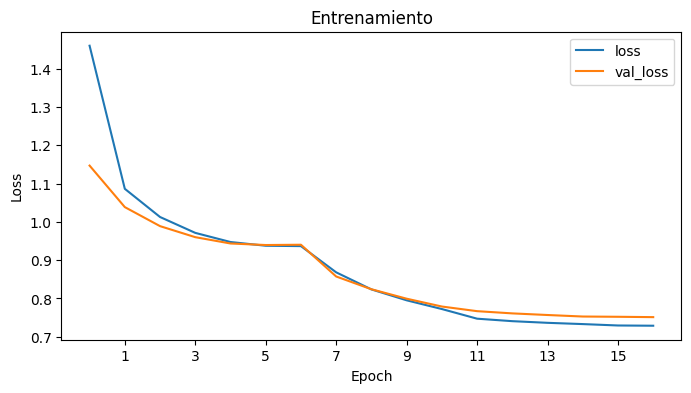

In [ ]:
metrics = history.history

plt.figure(figsize=(8,4))
plt.plot(history.epoch, metrics['loss'])
plt.plot(history.epoch, metrics['val_loss'])
plt.xticks(ticks=np.arange(1,history.epoch[-1],2))
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['loss', 'val_loss'])
plt.title('Entrenamiento')
plt.show()

* A las 15 épocas de entrenamiento la curva parece haberse estabilizado
* El overfitting es insignificante al igual que en los demás modelos

### 7.8. *Generación de texto*

#### 7.8.1. **Clase para predecir**

In [ ]:
class OneStep(tf.keras.Model):
  def __init__(self, model, chars_from_ids, ids_from_chars, temperature=1.0):
    super().__init__()
    self.temperature = temperature
    self.model = model
    self.chars_from_ids = id_a_caracter
    self.ids_from_chars = caracter_a_id

    skip_ids = self.ids_from_chars(['[UNK]'])[:, None]
    sparse_mask = tf.SparseTensor(
        values=[-float('inf')]*len(skip_ids),
        indices=skip_ids,
        dense_shape=[len(ids_from_chars.get_vocabulary())])
    self.prediction_mask = tf.sparse.to_dense(sparse_mask)

  @tf.function
  def generate_one_step(self, inputs, states=None):
    input_chars = tf.strings.unicode_split(inputs, 'UTF-8')
    input_ids = self.ids_from_chars(input_chars).to_tensor()

    predicted_logits, states = self.model(inputs=input_ids, states=states,
                                          return_state=True)

    predicted_logits = predicted_logits[:, -1, :]
    predicted_logits = predicted_logits/self.temperature
    predicted_logits = predicted_logits + self.prediction_mask

    predicted_ids = tf.random.categorical(predicted_logits, num_samples=1)
    predicted_ids = tf.squeeze(predicted_ids, axis=-1)

    predicted_chars = self.chars_from_ids(predicted_ids)
    return predicted_chars, states

#### 7.8.2. **Cargamos el modelo en caso de ser necesario**

Es necesario crear un modelo con la misma arquitecturas e hiperparametros que el original. El bloque de abajo es para utilizar el modelo en caso de tener los checkpoints con los pesos guardados.

In [ ]:
modelo = MyModel(
    vocab_size=tamaño_vocabulario,
    embedding_dim=dimension_embedding,
    rnn_units=unidades_rnn)

loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

modelo.compile(optimizer='adam', loss=loss)

checkpoint_name = "mejor_modelo_1"

# Cargamos los pesos en el modelo
modelo.load_weights(checkpoint_name)

#### 7.8.3. **Predecimos**

In [ ]:
one_step_model = OneStep(model, id_a_caracter, caracter_a_id)

start = time.time()
states = None
next_char = tf.constant(['AMD'])
result = [next_char]

for n in range(2000):
  next_char, states = one_step_model.generate_one_step(next_char, states=states)
  result.append(next_char)

# Dividimos las oraciones
result = tf.strings.join(result)
result = result.numpy()[0].decode('utf-8')
oraciones = result.split(sep='\n')[:]
oraciones = oraciones[:-1]

# Mostramos las oraciones resultantes
print('---'*50+'\n')
c=1
for oracion in oraciones:
    print(f'Noticia {c}: {oracion}\n')
    c+=1
print('---'*50)
end = time.time()

print('\nRun time:', end - start, '\n')
print('---'*50)

------------------------------------------------------------------------------------------------------------------------------------------------------

Noticia 1: AMD's Quebec Corp. , the world's biggest airline told up to  $150 million from August, Statistics Catthring said 

Noticia 2: Health care giant Microsoft on Thursday announced just for new and mobile phone carrier (DSL) and executive leaders to use its minority winery connecting to their cells and attack. Last defense has successfully, scientists said Thursday.

Noticia 3:  NEW YORK (Reuters) - U.S. stocks rose modestly in August, government data showed on Thursday, with Microsoft Corp. has given up a good shift in its bottom-field record and prices and sales posted almost  $9 a barrel yesterday, bringing permits to boost bankruptcy prices.

Noticia 4: Baghdad - Palestinian militants ahead of a car bombing at the seven-month new offensive they found their main twins, dreaming of rocks aren't the black storm to be guilty of si

* Las oraciones se mantienen en la misma linea que los dos anteriores modelos
* Mantiene el buen uso de las comas y los puntos. Ya entiende donde colocar sustantivos, verbos y adjetivos
* Sigue inventando palabras pero en menor medida
* Las oraciones empiezan a tener un poco de sentido con respecto a los otros modelos, aunque siguen siendo incoherentes

## 8. *Conclusiones*

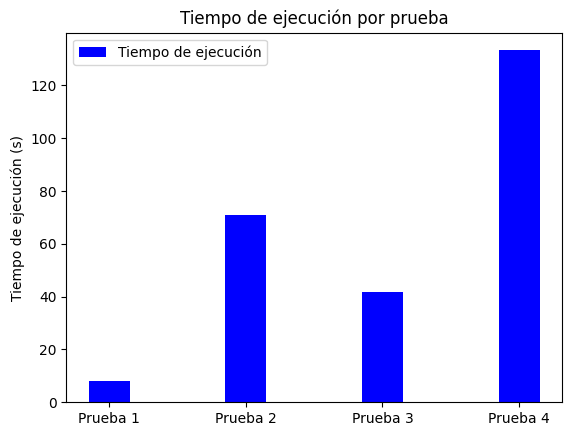

In [ ]:
# Tiempo de ejecución de cada prueba
time_test1, time_test2, time_test3, time_test4 = round(total_time_test1, 2), round(total_time_test2, 2), round(total_time_test3, 2), round(total_time_test4, 2)
tiempo = [time_test1, time_test2, time_test3, time_test4]

# Etiquetas para las pruebas
labels = ['Prueba 1', 'Prueba 2', 'Prueba 3', 'Prueba 4']

x = np.arange(len(labels))
width = 0.3

# Gráfico de barras
fig, ax = plt.subplots()

# Barras para el tiempo de ejecución
ax.bar(x, tiempo, width, label='Tiempo de ejecución', color='b')

# Etiquetas, título y leyenda
ax.set_ylabel('Tiempo de ejecución (s)')
ax.set_title('Tiempo de ejecución por prueba')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

plt.show()

Lo que podemos ver a partir de esta comparación es que, los modelos 4 y 2 que no necesariamente son los más complejos, fueron los que mejor métricas sacaron. En caso del **Modelo 2: una única capa de GRU de 2048 celdas** obtuvo un **~0.8695** de perdidas *(loss)* mientras que el **Modelo 4: Una única capa LSTM** obtuvo un **~0.7513** de perdida.

El Modelo 4 fue, por mucho, el modelo que más tardó en terminar de entrenar, pero a su vez fue el modelo que mejor métrica sacó. Esto, por consecuencia, nos deja como única alternativa a elegir el Modelo 4, ya que, a pesar del amplio tiempo de entrenamiento que conlleva, su rendimiento supera a los demás modelos con diferencia.  